In [1]:
import glob, os
import pathlib
import json
import yaml

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import collections
from pprint import pprint

%matplotlib inline

In [2]:
# avoid the module's method call deprecation
try:
    collectionsAbc = collections.abc
except AttributeError:
    collectionsAbc = collections

In [3]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

# Functions to use

### Function to fully flatten each json file

In [4]:
def flatten_dict_full(d, sep="_"):
    obj = collections.OrderedDict()

    def recurse(t, parent_key=""):
        
        if isinstance(t, list):
            for i in range(len(t)):
                recurse(t[i], parent_key + sep + str(i) if parent_key else str(i))
        elif isinstance(t,dict):
            for k, v in t.items():
                recurse(v, parent_key + sep + k if parent_key else k)
        else:
            obj[parent_key] = t
    recurse(d)

    return obj

# Load Data GrounTruth

In [5]:
path_obj = pathlib.Path().absolute()

In [6]:
path_app = path_obj.as_posix()
print('Current path:', path_app)
print('Type:', type(path_app))

Current path: /Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure
Type: <class 'str'>


In [7]:
path_app = os.path.abspath(os.getcwd())
# path = os.path.join(path, 'danceability', 'features', 'mp3')
print('Current path:', path_app)
print('Type:', type(path_app))

Current path: /Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure
Type: <class 'str'>


In [8]:
counter = 0
for root, dirs, files in os.walk(path_app):
    for file in files:
        if(file.endswith(".json")):
#             print(os.path.join(root,file))
            counter += 1
            
print('counted json files:', counter)        

counted json files: 10461


In [9]:
with open(os.path.join(path_app, 'acousticbrainz-datasets/danceability/metadata/groundtruth.yaml'), 'r') as stream:
    try:
        groundTr_data = yaml.safe_load(stream)
    except yaml.YAMLError as exc:
        print(exc)

In [10]:
pprint(groundTr_data)

{'className': 'danceability',
 'groundTruth': {'Alternative/02 Happy Birthday - Altered Images.mp3': 'danceable',
                 'Alternative/03 How Soon Is Now - Smiths.mp3': 'not_danceable',
                 "Alternative/04 Pearly Dewdrops' Drops - Cocteau Twins.mp3": 'not_danceable',
                 'Alternative/06 Mr Brightside - Killers.mp3': 'danceable',
                 'Alternative/06 Song 2 - Blur.mp3': 'danceable',
                 'Alternative/07 Honest Mistake - Bravery.mp3': 'danceable',
                 'Alternative/10 Brassneck - Wedding Present.mp3': 'danceable',
                 'Alternative/19 Love Will Tear Us Apart - Joy Division.mp3': 'danceable',
                 'Alternative/Ever Fallen In Love - Buzzcocks.mp3': 'danceable',
                 'Blues/05 Shotgun Blues.mp3': 'not_danceable',
                 "Blues/06 Standin' at the Station.mp3": 'not_danceable',
                 "Blues/08 Cryin' and Driftin' Blues.mp3": 'not_danceable',
                 'Blues/0

In [11]:
pprint(groundTr_data['groundTruth'])

{'Alternative/02 Happy Birthday - Altered Images.mp3': 'danceable',
 'Alternative/03 How Soon Is Now - Smiths.mp3': 'not_danceable',
 "Alternative/04 Pearly Dewdrops' Drops - Cocteau Twins.mp3": 'not_danceable',
 'Alternative/06 Mr Brightside - Killers.mp3': 'danceable',
 'Alternative/06 Song 2 - Blur.mp3': 'danceable',
 'Alternative/07 Honest Mistake - Bravery.mp3': 'danceable',
 'Alternative/10 Brassneck - Wedding Present.mp3': 'danceable',
 'Alternative/19 Love Will Tear Us Apart - Joy Division.mp3': 'danceable',
 'Alternative/Ever Fallen In Love - Buzzcocks.mp3': 'danceable',
 'Blues/05 Shotgun Blues.mp3': 'not_danceable',
 "Blues/06 Standin' at the Station.mp3": 'not_danceable',
 "Blues/08 Cryin' and Driftin' Blues.mp3": 'not_danceable',
 'Blues/08 Evil Hearted Woman.mp3': 'not_danceable',
 'Blues/09 Double Trouble Blues.mp3': 'not_danceable',
 'Blues/10 When It Rains It Pours.mp3': 'not_danceable',
 'Blues/11 Key to the Highway.mp3': 'not_danceable',
 "Blues/13 That's All Right.m

In [12]:
len(groundTr_data['groundTruth'].keys())

225

In [13]:
labeled_tracks = groundTr_data['groundTruth']

In [14]:
folders = []
for key in labeled_tracks:
    key = key.split('/')
    folders.append(key[0])

In [15]:
print(folders[:15])

['Alternative', 'Alternative', 'Alternative', 'Alternative', 'Alternative', 'Alternative', 'Alternative', 'Alternative', 'Alternative', 'Blues', 'Blues', 'Blues', 'Blues', 'Blues', 'Blues']


In [16]:
folders = set(folders)
folders = list(folders)
folders.sort()
folders

['Alternative',
 'Blues',
 'Classical',
 'Country',
 'Dance and House',
 'Folk and New Age',
 'Hip-Hop and Rap',
 'House & Garage and Grime',
 'Jazz',
 'Jungle and D&B',
 'Latin',
 'Pop',
 'R&B and Soul',
 'Reggae',
 'Rock and Metal',
 'Techno and Electro',
 'Vocal and Acapella']

In [17]:
class_name = groundTr_data['className']

In [18]:
path_features = os.path.join(path_app, 'acousticbrainz-datasets/danceability', 'features', 'mp3')

In [19]:
path_features

'/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3'

In [20]:
tracks = []
for key, value in labeled_tracks.items():
    track_dict = {}
    key = key.split('/')
    path_tracks = os.path.join(path_features, key[0])
    for f_name in os.listdir(path_tracks):
        if f_name.startswith(key[1]):
            track_dict['category'] = key[0]
            track_dict['track'] = key[1]
            track_dict['track_path'] = os.path.join(path_features, key[0], f_name)
            track_dict['danceability'] = value
    tracks.append(track_dict)

In [21]:
pprint(tracks)

[{'category': 'Alternative',
  'danceability': 'danceable',
  'track': '02 Happy Birthday - Altered Images.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/02 '
                'Happy Birthday - Altered Images.mp3.json'},
 {'category': 'Alternative',
  'danceability': 'not_danceable',
  'track': '03 How Soon Is Now - Smiths.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/03 '
                'How Soon Is Now - Smiths.mp3.json'},
 {'category': 'Alternative',
  'danceability': 'not_danceable',
  'track': "04 Pearly Dewdrops' Drops - Cocteau Twins.mp3",
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/04 '
                "Pearly Dewdrops' Drops - Cocteau Twins.mp3.json"},
 {'category': 'Alter

  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/House '
                '& Garage and Grime/06 Rip Groove.mp3.json'},
 {'category': 'House & Garage and Grime',
  'danceability': 'danceable',
  'track': '08 What You Want.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/House '
                '& Garage and Grime/08 What You Want.mp3.json'},
 {'category': 'House & Garage and Grime',
  'danceability': 'danceable',
  'track': '09 Anytime.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/House '
                '& Garage and Grime/09 Anytime.mp3.json'},
 {'category': 'House & Garage and Grime',
  'danceability': 'danceable',
  'track': '11 Coming Home.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrast

 {'category': 'Latin',
  'danceability': 'danceable',
  'track': "09 Good Life (Buena Vida) [Tommy Onyx's Summer Fiesta Radio "
           'Mix].mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Latin/09 '
                "Good Life (Buena Vida) [Tommy Onyx's Summer Fiesta Radio "
                'Mix].mp3.json'},
 {'category': 'Latin',
  'danceability': 'danceable',
  'track': '11 Lambada.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Latin/11 '
                'Lambada.mp3.json'},
 {'category': 'Latin',
  'danceability': 'danceable',
  'track': '12 Que Humanidad - Oquendo, Manny & Libre.mp3',
  'track_path': '/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Latin/12 '
                'Que Humanidad - Oquendo, Manny & Libre.mp3.json'},
 {'ca

In [22]:
len(tracks)

225

In [23]:
df_tracks = pd.DataFrame(data=tracks)

In [24]:
df_tracks.head()

,category,track,track_path,danceability
0,Alternative,02 Happy Birthday - Altered Images.mp3,/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/02 Happy Birthday - Altered Images.mp3.json,danceable
1,Alternative,03 How Soon Is Now - Smiths.mp3,/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/03 How Soon Is Now - Smiths.mp3.json,not_danceable
2,Alternative,04 Pearly Dewdrops' Drops - Cocteau Twins.mp3,/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/04 Pearly Dewdrops' Drops - Cocteau Twins.mp3.json,not_danceable
3,Alternative,06 Mr Brightside - Killers.mp3,/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/06 Mr Brightside - Killers.mp3.json,danceable
4,Alternative,06 Song 2 - Blur.mp3,/Users/pantelistzamalis/Desktop/google2020/gsoc_ml_infrastructure/acousticbrainz-datasets/danceability/features/mp3/Alternative/06 Song 2 - Blur.mp3.json,danceable


array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a1e7b9a50>,
      dtype=object)

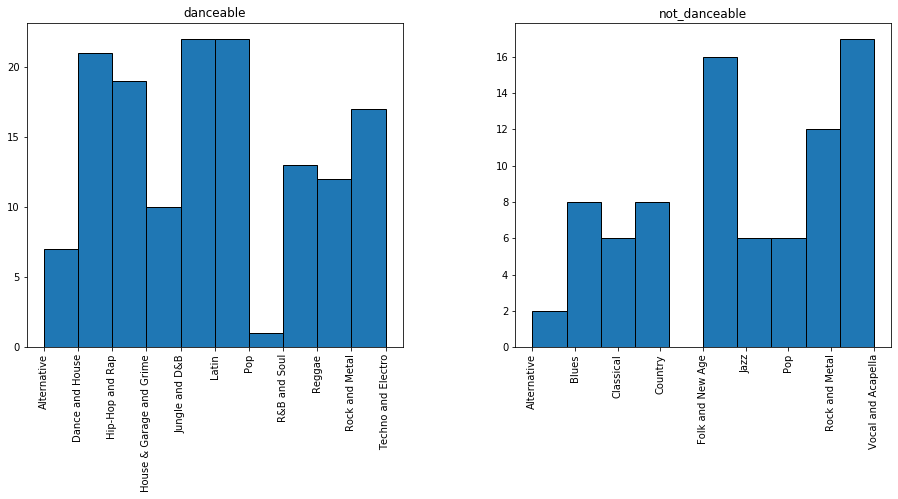

In [25]:
df_tracks.hist('category', class_name, figsize=(15,6), edgecolor="k")

In [26]:
df_tracks['category'].value_counts()

Latin                       22
Jungle and D&B              22
Dance and House             21
Hip-Hop and Rap             19
Vocal and Acapella          17
Folk and New Age            16
Techno and Electro          16
R&B and Soul                13
Rock and Metal              13
Reggae                      12
House & Garage and Grime    10
Alternative                  9
Country                      8
Blues                        8
Pop                          7
Classical                    6
Jazz                         6
Name: category, dtype: int64

# Load a Single JSON low-level

In [27]:
with open(df_tracks['track_path'].iloc[0]) as json_file:
    data_feats = json.load(json_file)

In [28]:
pprint(data_feats)

{'lowlevel': {'average_loudness': 0.940232157707,
              'barkbands': {'dmean': [7.17182338121e-05,
                                      0.00266144284979,
                                      0.00178887031507,
                                      0.0018207145622,
                                      0.00237804092467,
                                      0.00111001369078,
                                      0.00145341933239,
                                      0.00081869593123,
                                      0.000793467450421,
                                      0.000962446560152,
                                      0.000713575980626,
                                      0.000607903581113,
                                      0.000297889113426,
                                      0.000444663950475,
                                      0.000292485550744,
                                      0.000312219141051,
                                      0.000352

                                   1.03989625799e-08,
                                   4.08592937262e-09,
                                   4.70022021304e-09,
                                   3.82715459324e-09,
                                   1.69590785859e-09,
                                   3.58760776642e-09,
                                   3.33473582081e-10,
                                   4.66504224139e-10,
                                   1.42583111984e-09,
                                   7.26281756958e-10,
                                   3.2886765533e-10,
                                   2.36522967878e-10,
                                   3.02053243528e-10,
                                   1.18333148835e-10,
                                   4.38045086315e-11,
                                   5.56769248761e-11,
                                   5.98522689743e-11,
                                   3.16184821381e-11,
                             

                               73.8162307739,
                               74.210975647,
                               74.5941009521,
                               74.9772338867,
                               75.3603591919,
                               75.7551040649,
                               76.1382293701,
                               76.5213623047,
                               76.9044876099,
                               77.2992248535,
                               77.6707458496,
                               78.0538787842,
                               78.4370040894,
                               78.831741333,
                               79.2148742676,
                               79.5979995728,
                               79.9811325073,
                               80.3642578125,
                               80.7590026855,
                               81.1421279907,
                               81.5252609253,
                               81.90

In [29]:
data_feats.keys()

dict_keys(['lowlevel', 'metadata', 'rhythm', 'tonal'])

### metadata

In [30]:
data_feats['metadata']

{'audio_properties': {'analysis_sample_rate': 44100,
  'bit_rate': 128000,
  'equal_loudness': 0,
  'length': 178.259597778,
  'lossless': 0,
  'replay_gain': -15.0935020447,
  'sample_rate': 44100,
  'codec': 'mp3',
  'downmix': 'mix',
  'md5_encoded': '9a09eb0c8b468e32c61ab36080f0f5f0'},
 'tags': {'file_name': '02 Happy Birthday - Altered Images.mp3',
  'album': ['John Peel - A Tribute [UK] Disc 2'],
  'albumartist': ['Various Artists'],
  'artist': ['Various Artists'],
  'date': ['2005'],
  'genre': ['Rock/Pop'],
  'label': ['WSM'],
  'length': ['178320'],
  'title': ['Happy Birthday - Altered Images'],
  'tracknumber': ['2']},
 'version': {'essentia': '2.1-beta2',
  'essentia_git_sha': 'v2.1_beta2',
  'extractor': 'music 1.0'}}

In [31]:
data_feats['metadata'].keys()

dict_keys(['audio_properties', 'tags', 'version'])

### Function to fully flatten each json file

In [32]:
def flatten_dict_full(d, sep="_"):
    obj = collections.OrderedDict()

    def recurse(t, parent_key=""):
        
        if isinstance(t, list):
            for i in range(len(t)):
                recurse(t[i], parent_key + sep + str(i) if parent_key else str(i))
        elif isinstance(t,dict):
            for k, v in t.items():
                recurse(v, parent_key + sep + k if parent_key else k)
        else:
            obj[parent_key] = t
    recurse(d)

    return obj

### enumeration - tonal
Enumeration in: 'tonal.chords_key', 'tonal.chords_scale', 'tonal.key_key', 'tonal.key_scale'

In [33]:
data_feats['tonal']

{'chords_changes_rate': 0.0486979149282,
 'chords_number_rate': 0.00156250002328,
 'chords_strength': {'dmean': 0.0096388598904,
  'dmean2': 0.00920399092138,
  'dvar': 7.79607071308e-05,
  'dvar2': 8.22892325232e-05,
  'max': 0.729928433895,
  'mean': 0.543790280819,
  'median': 0.548757076263,
  'min': 0.319358617067,
  'var': 0.00577862840146},
 'hpcp_entropy': {'dmean': 0.69612121582,
  'dmean2': 1.16250741482,
  'dvar': 0.312043368816,
  'dvar2': 0.835178256035,
  'max': 4.54649114609,
  'mean': 1.88715350628,
  'median': 1.92927026749,
  'min': 0,
  'var': 0.695105791092},
 'key_strength': 0.766087949276,
 'tuning_diatonic_strength': 0.693597137928,
 'tuning_equal_tempered_deviation': 0.097228333354,
 'tuning_frequency': 440.254241943,
 'tuning_nontempered_energy_ratio': 0.748715221882,
 'hpcp': {'dmean': [0.217552050948,
   0.213383167982,
   0.148033186793,
   0.108217962086,
   0.0993325561285,
   0.110476128757,
   0.132857397199,
   0.10944224149,
   0.0683141797781,
   0.06

In [34]:
enum_keys = ['chords_key', 'chords_scale', 'key_key', 'key_scale']
for item in enum_keys:
    if item in list(data_feats['tonal'].keys()):
        print('{}: {}'.format(item, data_feats['tonal'][item]))

chords_key: A
chords_scale: major
key_key: D
key_scale: minor


In [35]:
data_feats['tonal'].keys()

dict_keys(['chords_changes_rate', 'chords_number_rate', 'chords_strength', 'hpcp_entropy', 'key_strength', 'tuning_diatonic_strength', 'tuning_equal_tempered_deviation', 'tuning_frequency', 'tuning_nontempered_energy_ratio', 'hpcp', 'chords_histogram', 'thpcp', 'chords_key', 'chords_scale', 'key_key', 'key_scale'])

### low-level

In [36]:
low_level = data_feats['lowlevel']

In [37]:
low_level.keys()

dict_keys(['average_loudness', 'barkbands_crest', 'barkbands_flatness_db', 'barkbands_kurtosis', 'barkbands_skewness', 'barkbands_spread', 'dissonance', 'dynamic_complexity', 'erbbands_crest', 'erbbands_flatness_db', 'erbbands_kurtosis', 'erbbands_skewness', 'erbbands_spread', 'hfc', 'melbands_crest', 'melbands_flatness_db', 'melbands_kurtosis', 'melbands_skewness', 'melbands_spread', 'pitch_salience', 'silence_rate_20dB', 'silence_rate_30dB', 'silence_rate_60dB', 'spectral_centroid', 'spectral_complexity', 'spectral_decrease', 'spectral_energy', 'spectral_energyband_high', 'spectral_energyband_low', 'spectral_energyband_middle_high', 'spectral_energyband_middle_low', 'spectral_entropy', 'spectral_flux', 'spectral_kurtosis', 'spectral_rms', 'spectral_rolloff', 'spectral_skewness', 'spectral_spread', 'spectral_strongpeak', 'zerocrossingrate', 'barkbands', 'erbbands', 'gfcc', 'melbands', 'mfcc', 'spectral_contrast_coeffs', 'spectral_contrast_valleys'])

### rhythm

In [38]:
rhythm = data_feats['rhythm']

In [39]:
rhythm.keys()

dict_keys(['beats_count', 'beats_loudness', 'bpm', 'bpm_histogram_first_peak_bpm', 'bpm_histogram_first_peak_spread', 'bpm_histogram_first_peak_weight', 'bpm_histogram_second_peak_bpm', 'bpm_histogram_second_peak_spread', 'bpm_histogram_second_peak_weight', 'danceability', 'onset_rate', 'beats_loudness_band_ratio', 'beats_position'])

In [40]:
pprint(rhythm)

{'beats_count': 461,
 'beats_loudness': {'dmean': 0.0148677146062,
                    'dmean2': 0.0268618911505,
                    'dvar': 0.000128367319121,
                    'dvar2': 0.000436142960098,
                    'max': 0.0906557664275,
                    'mean': 0.039526373148,
                    'median': 0.0406146533787,
                    'min': 5.0987480904e-09,
                    'var': 0.000368354580132},
 'beats_loudness_band_ratio': {'dmean': [0.15134857595,
                                         0.122174568474,
                                         0.120469264686,
                                         0.0859476923943,
                                         0.0327482074499,
                                         0.0497110560536],
                               'dmean2': [0.254409939051,
                                          0.208379983902,
                                          0.20235915482,
                                          0.15

## Remove the `metadata` key

In [41]:
data_feats.keys()

dict_keys(['lowlevel', 'metadata', 'rhythm', 'tonal'])

In [42]:
if 'metadata' in data_feats:
    del data_feats['metadata']

In [43]:
data_feats.keys()

dict_keys(['lowlevel', 'rhythm', 'tonal'])

In [44]:
print(data_feats['rhythm'].keys())
print()
print('length:', len(list(data_feats['rhythm'].keys())))

dict_keys(['beats_count', 'beats_loudness', 'bpm', 'bpm_histogram_first_peak_bpm', 'bpm_histogram_first_peak_spread', 'bpm_histogram_first_peak_weight', 'bpm_histogram_second_peak_bpm', 'bpm_histogram_second_peak_spread', 'bpm_histogram_second_peak_weight', 'danceability', 'onset_rate', 'beats_loudness_band_ratio', 'beats_position'])

length: 13


In [45]:
if 'beats_position' in data_feats['rhythm']:
    del data_feats['rhythm']['beats_position']

In [46]:
print(data_feats['rhythm'].keys())
print()
print('length:', len(list(data_feats['rhythm'].keys())))

dict_keys(['beats_count', 'beats_loudness', 'bpm', 'bpm_histogram_first_peak_bpm', 'bpm_histogram_first_peak_spread', 'bpm_histogram_first_peak_weight', 'bpm_histogram_second_peak_bpm', 'bpm_histogram_second_peak_spread', 'bpm_histogram_second_peak_weight', 'danceability', 'onset_rate', 'beats_loudness_band_ratio'])

length: 12


## Transform to a single DF

In [47]:
data_feats = flatten_dict_full(data_feats)

In [48]:
len(data_feats.keys())

2651

In [49]:
df_single_track = pd.DataFrame(data_feats, columns=data_feats.keys(), index=[0])

In [50]:
df_single_track

,lowlevel_average_loudness,lowlevel_barkbands_crest_dmean,lowlevel_barkbands_crest_dmean2,lowlevel_barkbands_crest_dvar,lowlevel_barkbands_crest_dvar2,lowlevel_barkbands_crest_max,lowlevel_barkbands_crest_mean,lowlevel_barkbands_crest_median,lowlevel_barkbands_crest_min,lowlevel_barkbands_crest_var,lowlevel_barkbands_flatness_db_dmean,lowlevel_barkbands_flatness_db_dmean2,lowlevel_barkbands_flatness_db_dvar,lowlevel_barkbands_flatness_db_dvar2,lowlevel_barkbands_flatness_db_max,lowlevel_barkbands_flatness_db_mean,lowlevel_barkbands_flatness_db_median,lowlevel_barkbands_flatness_db_min,lowlevel_barkbands_flatness_db_var,lowlevel_barkbands_kurtosis_dmean,lowlevel_barkbands_kurtosis_dmean2,lowlevel_barkbands_kurtosis_dvar,lowlevel_barkbands_kurtosis_dvar2,lowlevel_barkbands_kurtosis_max,lowlevel_barkbands_kurtosis_mean,lowlevel_barkbands_kurtosis_median,lowlevel_barkbands_kurtosis_min,lowlevel_barkbands_kurtosis_var,lowlevel_barkbands_skewness_dmean,lowlevel_barkbands_skewness_dmean2,lowlevel_barkbands_skewness_dvar,lowlevel_barkbands_skewness_dvar2,lowlevel_barkbands_skewness_max,lowlevel_barkbands_skewness_mean,lowlevel_barkbands_skewness_median,lowlevel_barkbands_skewness_min,lowlevel_barkbands_skewness_var,lowlevel_barkbands_spread_dmean,lowlevel_barkbands_spread_dmean2,lowlevel_barkbands_spread_dvar,lowlevel_barkbands_spread_dvar2,lowlevel_barkbands_spread_max,lowlevel_barkbands_spread_mean,lowlevel_barkbands_spread_median,lowlevel_barkbands_spread_min,lowlevel_barkbands_spread_var,lowlevel_dissonance_dmean,lowlevel_dissonance_dmean2,lowlevel_dissonance_dvar,lowlevel_dissonance_dvar2,lowlevel_dissonance_max,lowlevel_dissonance_mean,lowlevel_dissonance_median,lowlevel_dissonance_min,lowlevel_dissonance_var,lowlevel_dynamic_complexity,lowlevel_erbbands_crest_dmean,lowlevel_erbbands_crest_dmean2,lowlevel_erbbands_crest_dvar,lowlevel_erbbands_crest_dvar2,lowlevel_erbbands_crest_max,lowlevel_erbbands_crest_mean,lowlevel_erbbands_crest_median,lowlevel_erbbands_crest_min,lowlevel_erbbands_crest_var,lowlevel_erbbands_flatness_db_dmean,lowlevel_erbbands_flatness_db_dmean2,lowlevel_erbbands_flatness_db_dvar,lowlevel_erbbands_flatness_db_dvar2,lowlevel_erbbands_flatness_db_max,lowlevel_erbbands_flatness_db_mean,lowlevel_erbbands_flatness_db_median,lowlevel_erbbands_flatness_db_min,lowlevel_erbbands_flatness_db_var,lowlevel_erbbands_kurtosis_dmean,lowlevel_erbbands_kurtosis_dmean2,lowlevel_erbbands_kurtosis_dvar,lowlevel_erbbands_kurtosis_dvar2,lowlevel_erbbands_kurtosis_max,lowlevel_erbbands_kurtosis_mean,lowlevel_erbbands_kurtosis_median,lowlevel_erbbands_kurtosis_min,lowlevel_erbbands_kurtosis_var,lowlevel_erbbands_skewness_dmean,lowlevel_erbbands_skewness_dmean2,lowlevel_erbbands_skewness_dvar,lowlevel_erbbands_skewness_dvar2,lowlevel_erbbands_skewness_max,lowlevel_erbbands_skewness_mean,lowlevel_erbbands_skewness_median,lowlevel_erbbands_skewness_min,lowlevel_erbbands_skewness_var,lowlevel_erbbands_spread_dmean,lowlevel_erbbands_spread_dmean2,lowlevel_erbbands_spread_dvar,lowlevel_erbbands_spread_dvar2,lowlevel_erbbands_spread_max,lowlevel_erbbands_spread_mean,lowlevel_erbbands_spread_median,lowlevel_erbbands_spread_min,lowlevel_erbbands_spread_var,lowlevel_hfc_dmean,lowlevel_hfc_dmean2,lowlevel_hfc_dvar,lowlevel_hfc_dvar2,lowlevel_hfc_max,lowlevel_hfc_mean,lowlevel_hfc_median,lowlevel_hfc_min,lowlevel_hfc_var,lowlevel_melbands_crest_dmean,lowlevel_melbands_crest_dmean2,lowlevel_melbands_crest_dvar,lowlevel_melbands_crest_dvar2,lowlevel_melbands_crest_max,lowlevel_melbands_crest_mean,lowlevel_melbands_crest_median,lowlevel_melbands_crest_min,lowlevel_melbands_crest_var,lowlevel_melbands_flatness_db_dmean,lowlevel_melbands_flatness_db_dmean2,lowlevel_melbands_flatness_db_dvar,lowlevel_melbands_flatness_db_dvar2,lowlevel_melbands_flatness_db_max,lowlevel_melbands_flatness_db_mean,lowlevel_melbands_flatness_db_median,lowlevel_melbands_flatness_db_min,lowlevel_melbands_flatness_db_var,lowlevel_melbands_kurtosis_dmean,lowlevel_melbands_

In [51]:
df_single_track.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1 entries, 0 to 0
Columns: 2651 entries, lowlevel_average_loudness to tonal_key_scale
dtypes: float64(2492), int64(155), object(4)
memory usage: 20.7+ KB


# Features DF

### create an empty DF

In [52]:
list_feats_tracks = []

### Transform the features data and passing them to a fully features tracks DF

In [53]:
list_feats_tracks.clear()
counter_items_transformed = 0
for index, row in df_tracks.iterrows():
    f = open(row['track_path'])
    data_feats_item = json.load(f)

    # remove unnecessary data
    if 'metadata' in data_feats_item:
      del data_feats_item['metadata']
    if 'beats_position' in data_feats_item['rhythm']:
      del data_feats_item['rhythm']['beats_position']
    
    # data dictionary transformed to a fully flattened dictionary
    data_feats_item = flatten_dict_full(data_feats_item)

    # append to a full tracks features pandas df
    list_feats_tracks.append(dict(data_feats_item))
    
    counter_items_transformed += 1

print('Items parsed and transformed:', counter_items_transformed)

Items parsed and transformed: 225


In [54]:
len(list_feats_tracks)

225

In [55]:
list_feats_tracks

[{'lowlevel_average_loudness': 0.940232157707,
  'lowlevel_barkbands_crest_dmean': 2.76665973663,
  'lowlevel_barkbands_crest_dmean2': 4.44829654694,
  'lowlevel_barkbands_crest_dvar': 5.74580621719,
  'lowlevel_barkbands_crest_dvar2': 14.9876413345,
  'lowlevel_barkbands_crest_max': 26.7228469849,
  'lowlevel_barkbands_crest_mean': 10.8071289062,
  'lowlevel_barkbands_crest_median': 9.6913394928,
  'lowlevel_barkbands_crest_min': 2.79826569557,
  'lowlevel_barkbands_crest_var': 24.1222038269,
  'lowlevel_barkbands_flatness_db_dmean': 0.0237202681601,
  'lowlevel_barkbands_flatness_db_dmean2': 0.0359584279358,
  'lowlevel_barkbands_flatness_db_dvar': 0.000525934854522,
  'lowlevel_barkbands_flatness_db_dvar2': 0.0011579785496,
  'lowlevel_barkbands_flatness_db_max': 0.627937674522,
  'lowlevel_barkbands_flatness_db_mean': 0.176746591926,
  'lowlevel_barkbands_flatness_db_median': 0.146083265543,
  'lowlevel_barkbands_flatness_db_min': 0.0408386327326,
  'lowlevel_barkbands_flatness_db_

In [56]:
df_feats_tracks = pd.DataFrame(list_feats_tracks, columns=list_feats_tracks[0].keys())

In [57]:
df_feats_tracks.head()

lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804                               0.123771   
3                             0.096527                               0.074531   
4                             0.115602                               0.095726   

   lowlevel_barkbands_flatness_db_min  lowlevel_barkbands_flatness_db_var  \
0                            0.040839                            0.010974   
1                            0.025457                            0.001940   
2                            0.045240                  

In [58]:
df_feats_tracks.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 225 entries, 0 to 224
Columns: 2651 entries, lowlevel_average_loudness to tonal_key_scale
dtypes: float64(2573), int64(74), object(4)
memory usage: 4.6+ MB


In [59]:
df_feats_tracks.shape

(225, 2651)

### Concatenate the initial DF with the feats DF

In [60]:
df_tracks.columns

Index(['category', 'track', 'track_path', 'danceability'], dtype='object')

In [61]:
df_tracks.drop(labels=['track_path'], axis=1, inplace=True)

In [62]:
df_full_tracks = pd.concat([df_tracks, df_feats_tracks], axis=1)

In [63]:
df_full_tracks.head()

category                                          track   danceability  \
0  Alternative         02 Happy Birthday - Altered Images.mp3      danceable   
1  Alternative                03 How Soon Is Now - Smiths.mp3  not_danceable   
2  Alternative  04 Pearly Dewdrops' Drops - Cocteau Twins.mp3  not_danceable   
3  Alternative                 06 Mr Brightside - Killers.mp3      danceable   
4  Alternative                           06 Song 2 - Blur.mp3      danceable   

   lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804              

### check for empty values

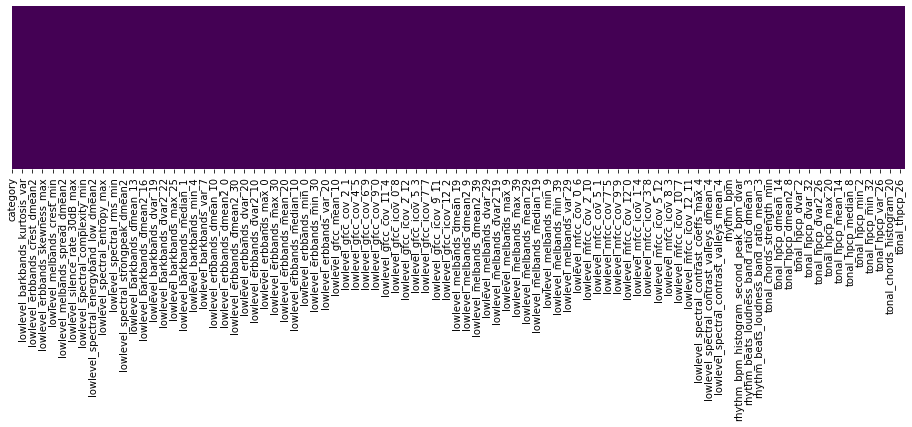

In [64]:
plt.figure(figsize=(16, 3))
sns.heatmap(df_full_tracks.isnull(), yticklabels=False, cbar=False, cmap='viridis')

There are no null values.

## Enumerate

###  check for non numerical values --> categorical data and explore this data

In [65]:
df_full_tracks.select_dtypes(include=['object']).head()

,category,track,danceability,tonal_chords_key,tonal_chords_scale,tonal_key_key,tonal_key_scale
0,Alternative,02 Happy Birthday - Altered Images.mp3,danceable,A,major,D,minor
1,Alternative,03 How Soon Is Now - Smiths.mp3,not_danceable,F#,major,F#,minor
2,Alternative,04 Pearly Dewdrops' Drops - Cocteau Twins.mp3,not_danceable,D,major,D,major
3,Alternative,06 Mr Brightside - Killers.mp3,danceable,C#,major,C#,major
4,Alternative,06 Song 2 - Blur.mp3,danceable,C,minor,G#,major


In [66]:
df_feats_tracks.select_dtypes(include=['object']).columns

Index(['tonal_chords_key', 'tonal_chords_scale', 'tonal_key_key',
       'tonal_key_scale'],
      dtype='object')

In [67]:
df_full_tracks['tonal_chords_key'].value_counts()

G     29
D     28
F     25
A     23
A#    21
E     20
C     20
C#    15
G#    14
D#    13
B      9
F#     8
Name: tonal_chords_key, dtype: int64

In [68]:
df_full_tracks['tonal_chords_scale'].value_counts()

major    125
minor    100
Name: tonal_chords_scale, dtype: int64

In [69]:
df_full_tracks['tonal_key_key'].value_counts()

F     30
A     28
D     28
C     27
D#    23
A#    21
G     18
E     14
C#    11
G#    10
F#     8
B      7
Name: tonal_key_key, dtype: int64

In [70]:
df_full_tracks['tonal_key_scale'].value_counts()

major    125
minor    100
Name: tonal_key_scale, dtype: int64

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a21d79790>,
      dtype=object)

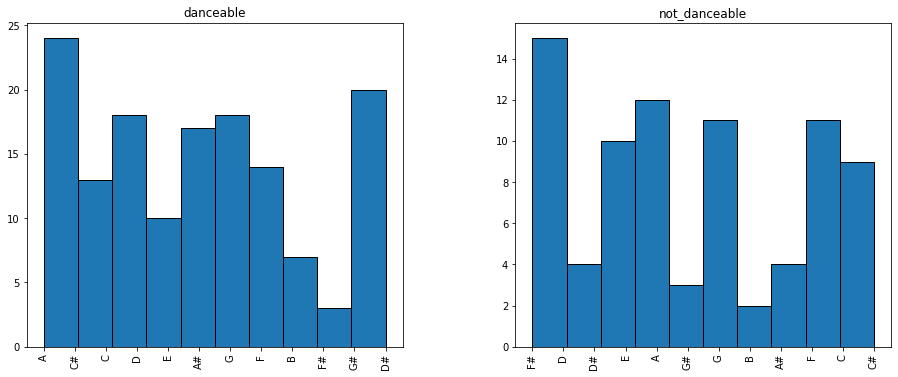

In [71]:
df_full_tracks.hist('tonal_chords_key', class_name, figsize=(15,6), edgecolor="k")

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a252594d0>,
      dtype=object)

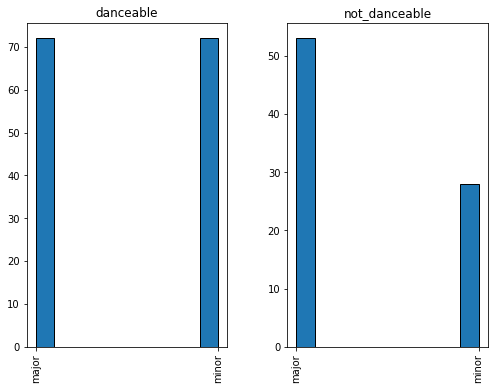

In [72]:
df_full_tracks.hist('tonal_chords_scale', class_name, figsize=(8,6), edgecolor="k")

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a254c7910>,
      dtype=object)

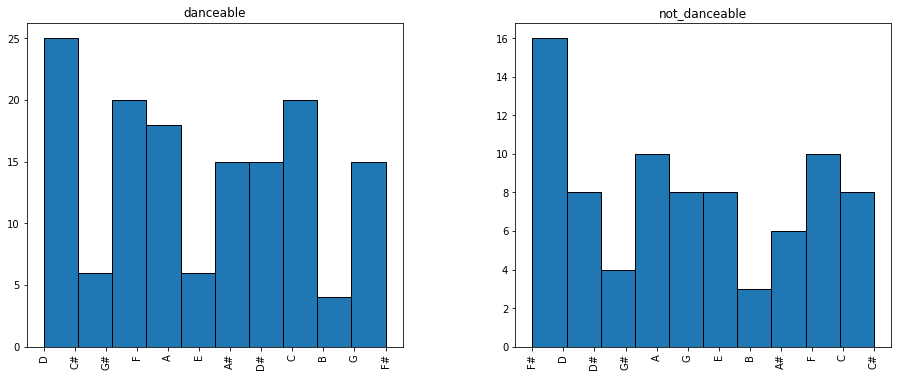

In [73]:
df_full_tracks.hist('tonal_key_key', class_name, figsize=(15,6), edgecolor="k")

array([<matplotlib.axes._subplots.AxesSubplot object at 0x1a25d194d0>,
      dtype=object)

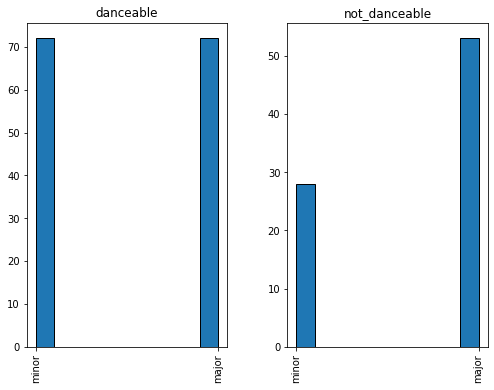

In [74]:
df_full_tracks.hist('tonal_key_scale', class_name, figsize=(8,6), edgecolor="k")

### One-hot encoding to categorical data

In [75]:
df_cat_full_tracks = df_full_tracks[['tonal_chords_key', 'tonal_chords_scale', 'tonal_key_key', 'tonal_key_scale']]

In [76]:
df_cat_full_tracks.head()

,tonal_chords_key,tonal_chords_scale,tonal_key_key,tonal_key_scale
0,A,major,D,minor
1,F#,major,F#,minor
2,D,major,D,major
3,C#,major,C#,major
4,C,minor,G#,major


In [77]:
df_cat_full_tracks_onehot = pd.get_dummies(df_cat_full_tracks)

In [78]:
df_cat_full_tracks_onehot.head()

,tonal_chords_key_A,tonal_chords_key_A#,tonal_chords_key_B,tonal_chords_key_C,tonal_chords_key_C#,tonal_chords_key_D,tonal_chords_key_D#,tonal_chords_key_E,tonal_chords_key_F,tonal_chords_key_F#,tonal_chords_key_G,tonal_chords_key_G#,tonal_chords_scale_major,tonal_chords_scale_minor,tonal_key_key_A,tonal_key_key_A#,tonal_key_key_B,tonal_key_key_C,tonal_key_key_C#,tonal_key_key_D,tonal_key_key_D#,tonal_key_key_E,tonal_key_key_F,tonal_key_key_F#,tonal_key_key_G,tonal_key_key_G#,tonal_key_scale_major,tonal_key_scale_minor
0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
3,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
4,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0


In [79]:
df_cat_full_tracks_onehot.columns

Index(['tonal_chords_key_A', 'tonal_chords_key_A#', 'tonal_chords_key_B',
       'tonal_chords_key_C', 'tonal_chords_key_C#', 'tonal_chords_key_D',
       'tonal_chords_key_D#', 'tonal_chords_key_E', 'tonal_chords_key_F',
       'tonal_chords_key_F#', 'tonal_chords_key_G', 'tonal_chords_key_G#',
       'tonal_chords_scale_major', 'tonal_chords_scale_minor',
       'tonal_key_key_A', 'tonal_key_key_A#', 'tonal_key_key_B',
       'tonal_key_key_C', 'tonal_key_key_C#', 'tonal_key_key_D',
       'tonal_key_key_D#', 'tonal_key_key_E', 'tonal_key_key_F',
       'tonal_key_key_F#', 'tonal_key_key_G', 'tonal_key_key_G#',
       'tonal_key_scale_major', 'tonal_key_scale_minor'],
      dtype='object')

In [80]:
len(list(df_cat_full_tracks_onehot.columns))

28

In [81]:
df_cat_full_tracks_onehot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 225 entries, 0 to 224
Data columns (total 28 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   tonal_chords_key_A        225 non-null    uint8
 1   tonal_chords_key_A#       225 non-null    uint8
 2   tonal_chords_key_B        225 non-null    uint8
 3   tonal_chords_key_C        225 non-null    uint8
 4   tonal_chords_key_C#       225 non-null    uint8
 5   tonal_chords_key_D        225 non-null    uint8
 6   tonal_chords_key_D#       225 non-null    uint8
 7   tonal_chords_key_E        225 non-null    uint8
 8   tonal_chords_key_F        225 non-null    uint8
 9   tonal_chords_key_F#       225 non-null    uint8
 10  tonal_chords_key_G        225 non-null    uint8
 11  tonal_chords_key_G#       225 non-null    uint8
 12  tonal_chords_scale_major  225 non-null    uint8
 13  tonal_chords_scale_minor  225 non-null    uint8
 14  tonal_key_key_A           225 non-null    

In [82]:
df_full_tracks.drop(labels=['tonal_chords_key', 'tonal_chords_scale', 'tonal_key_key', 'tonal_key_scale'], 
                    axis=1, inplace=True)

In [83]:
df_full_tracks.head()

category                                          track   danceability  \
0  Alternative         02 Happy Birthday - Altered Images.mp3      danceable   
1  Alternative                03 How Soon Is Now - Smiths.mp3  not_danceable   
2  Alternative  04 Pearly Dewdrops' Drops - Cocteau Twins.mp3  not_danceable   
3  Alternative                 06 Mr Brightside - Killers.mp3      danceable   
4  Alternative                           06 Song 2 - Blur.mp3      danceable   

   lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804              

In [84]:
df_full_tracks = pd.concat([df_full_tracks, df_cat_full_tracks_onehot], axis=1)

In [85]:
df_full_tracks.head()

category                                          track   danceability  \
0  Alternative         02 Happy Birthday - Altered Images.mp3      danceable   
1  Alternative                03 How Soon Is Now - Smiths.mp3  not_danceable   
2  Alternative  04 Pearly Dewdrops' Drops - Cocteau Twins.mp3  not_danceable   
3  Alternative                 06 Mr Brightside - Killers.mp3      danceable   
4  Alternative                           06 Song 2 - Blur.mp3      danceable   

   lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804              

### Target class - Label encoding and OneHot Encoding

In [86]:
class_name

'danceability'

#### Target Label Encoding

In [87]:
df_full_tracks['{}_code'.format(class_name)] = df_full_tracks[class_name]

In [88]:
df_full_tracks.head()

category                                          track   danceability  \
0  Alternative         02 Happy Birthday - Altered Images.mp3      danceable   
1  Alternative                03 How Soon Is Now - Smiths.mp3  not_danceable   
2  Alternative  04 Pearly Dewdrops' Drops - Cocteau Twins.mp3  not_danceable   
3  Alternative                 06 Mr Brightside - Killers.mp3      danceable   
4  Alternative                           06 Song 2 - Blur.mp3      danceable   

   lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804              

In [89]:
from sklearn.preprocessing import LabelEncoder

In [90]:
lb_make = LabelEncoder()

In [91]:
df_full_tracks['{}_code'.format(class_name)] = lb_make.fit_transform(df_full_tracks['{}_code'.format(class_name)])

In [92]:
df_full_tracks['{}_code'.format(class_name)].head()

0    0
1    1
2    1
3    0
4    0
Name: danceability_code, dtype: int64

In [93]:
lb_make.classes_

array(['danceable', 'not_danceable'], dtype=object)

In [94]:
df_full_tracks.head()

category                                          track   danceability  \
0  Alternative         02 Happy Birthday - Altered Images.mp3      danceable   
1  Alternative                03 How Soon Is Now - Smiths.mp3  not_danceable   
2  Alternative  04 Pearly Dewdrops' Drops - Cocteau Twins.mp3  not_danceable   
3  Alternative                 06 Mr Brightside - Killers.mp3      danceable   
4  Alternative                           06 Song 2 - Blur.mp3      danceable   

   lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804              

#### Target Class - One Hot Encoding

Can be used in Neural Networks, and some sklearn algorithms

In [95]:
df_target_onehot = pd.get_dummies(df_full_tracks[class_name], prefix='oh_{}'.format(class_name), prefix_sep='_')

In [96]:
df_target_onehot.head()

,oh_danceability_danceable,oh_danceability_not_danceable
0,1,0
1,0,1
2,0,1
3,1,0
4,1,0


In [97]:
df_full_tracks = pd.concat([df_full_tracks, df_target_onehot], axis=1)

In [98]:
df_full_tracks.head()

category                                          track   danceability  \
0  Alternative         02 Happy Birthday - Altered Images.mp3      danceable   
1  Alternative                03 How Soon Is Now - Smiths.mp3  not_danceable   
2  Alternative  04 Pearly Dewdrops' Drops - Cocteau Twins.mp3  not_danceable   
3  Alternative                 06 Mr Brightside - Killers.mp3      danceable   
4  Alternative                           06 Song 2 - Blur.mp3      danceable   

   lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804              

In [99]:
df_full_tracks.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 225 entries, 0 to 224
Columns: 2681 entries, category to oh_danceability_not_danceable
dtypes: float64(2573), int64(75), object(3), uint8(30)
memory usage: 4.6+ MB


# Preprocessing

## Selecting the kind of learning and taking the corrsponding features + Cleaning

In [100]:
# train kind: svm, deep_learning, supervised
train_kind = 'svm'

In [101]:
if train_kind is 'svm':
    df_tracks_ml = df_full_tracks.drop(labels=['category', 'track', 
                                               'danceability_code', 
                                               'oh_danceability_danceable', 
                                               'oh_danceability_not_danceable'], axis=1)

**X data**

In [102]:
X = df_tracks_ml.drop(labels=[class_name], axis=1)

In [103]:
X.shape

(225, 2675)

**y data**

In [104]:
y = df_tracks_ml[class_name]

In [105]:
X.head()

lowlevel_average_loudness  lowlevel_barkbands_crest_dmean  \
0                   0.940232                        2.766660   
1                   0.918468                        2.675291   
2                   0.903639                        2.680212   
3                   0.964146                        2.334805   
4                   0.923212                        2.654776   

   lowlevel_barkbands_crest_dmean2  lowlevel_barkbands_crest_dvar  \
0                         4.448297                       5.745806   
1                         4.377324                       6.211648   
2                         4.377909                       5.717108   
3                         3.876004                       6.314280   
4                         4.302909                       6.634628   

   lowlevel_barkbands_crest_dvar2  lowlevel_barkbands_crest_max  \
0                       14.987641                     26.722847   
1                       15.621523                     26.676046   
2                       13.717224                     24.490746   
3                       16.660341                     24.082594   
4                       16.935333                     26.224245   

   lowlevel_barkbands_crest_mean  lowlevel_barkbands_crest_median  \
0                      10.807129                         9.691339   
1                       8.789837                         8.108212   
2                       8.958855                         8.116771   
3                       7.989666                         7.193906   
4                       9.249996                         8.158960   

   lowlevel_barkbands_crest_min  lowlevel_barkbands_crest_var  \
0                      2.798266                     24.122204   
1                      2.419000                     12.385103   
2                      2.538304                     14.455623   
3                      2.510511                     11.031219   
4                      2.489789                     18.725180   

   lowlevel_barkbands_flatness_db_dmean  \
0                              0.023720   
1                              0.021670   
2                              0.020029   
3                              0.017094   
4                              0.020814   

   lowlevel_barkbands_flatness_db_dmean2  lowlevel_barkbands_flatness_db_dvar  \
0                               0.035958                             0.000526   
1                               0.033876                             0.000391   
2                               0.032708                             0.000378   
3                               0.027388                             0.000365   
4                               0.032149                             0.000563   

   lowlevel_barkbands_flatness_db_dvar2  lowlevel_barkbands_flatness_db_max  \
0                              0.001158                            0.627938   
1                              0.000961                            0.448718   
2                              0.000948                            0.291119   
3                              0.000918                            0.561661   
4                              0.001232                            0.386401   

   lowlevel_barkbands_flatness_db_mean  lowlevel_barkbands_flatness_db_median  \
0                             0.176747                               0.146083   
1                             0.113029                               0.105044   
2                             0.126804                               0.123771   
3                             0.096527                               0.074531   
4                             0.115602                               0.095726   

   lowlevel_barkbands_flatness_db_min  lowlevel_barkbands_flatness_db_var  \
0                            0.040839                            0.010974   
1                            0.025457                            0.001940   
2                            0.045240                  

In [106]:
X.dtypes

lowlevel_average_loudness                          float64
lowlevel_barkbands_crest_dmean                     float64
lowlevel_barkbands_crest_dmean2                    float64
lowlevel_barkbands_crest_dvar                      float64
lowlevel_barkbands_crest_dvar2                     float64
lowlevel_barkbands_crest_max                       float64
lowlevel_barkbands_crest_mean                      float64
lowlevel_barkbands_crest_median                    float64
lowlevel_barkbands_crest_min                       float64
lowlevel_barkbands_crest_var                       float64
lowlevel_barkbands_flatness_db_dmean               float64
lowlevel_barkbands_flatness_db_dmean2              float64
lowlevel_barkbands_flatness_db_dvar                float64
lowlevel_barkbands_flatness_db_dvar2               float64
lowlevel_barkbands_flatness_db_max                 float64
lowlevel_barkbands_flatness_db_mean                float64
lowlevel_barkbands_flatness_db_median              float

## Scaling

In [107]:
from sklearn.preprocessing import StandardScaler

In [108]:
scaler = StandardScaler()

In [109]:
scaler.fit(X)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [110]:
X_norm = scaler.transform(X)

In [111]:
X_norm

array([[ 0.6284611 , -0.30687451, -0.21902026, ..., -0.21566555,
        -1.11803399,  1.11803399],
       [ 0.54150004, -0.48057098, -0.30306602, ..., -0.21566555,
        -1.11803399,  1.11803399],
       [ 0.48225165, -0.47121687, -0.30237317, ..., -0.21566555,
         0.89442719, -0.89442719],
       ...,
       [-2.88465221, -0.35621679, -0.37293917, ..., -0.21566555,
         0.89442719, -0.89442719],
       [ 0.45241942, -0.56181505, -0.57801024, ..., -0.21566555,
        -1.11803399,  1.11803399],
       [-1.03276425, -0.61696614, -0.64636613, ..., -0.21566555,
        -1.11803399,  1.11803399]])

## PCA-95

In [112]:
from sklearn.decomposition import PCA

In [113]:
pca = PCA(n_components=.95)

In [114]:
pca.fit(X_norm)

PCA(copy=True, iterated_power='auto', n_components=0.95, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [115]:
X_pca = pca.transform(X_norm)

In [116]:
X_pca

array([[  6.76209704, -10.49134317,  -4.07373408, ...,  -0.06685304,
          2.17574526,   1.0414631 ],
       [ -0.45101817, -13.56006175,  12.40051172, ...,   1.93451344,
         -2.71647544,   0.7213484 ],
       [  4.04978249, -33.42037219,  15.65326558, ...,   0.20097504,
         -0.26575512,  -2.99868128],
       ...,
       [ 46.98902414,  35.60815786,  21.24537383, ...,  -0.28742366,
         -1.6504424 ,   2.00863663],
       [ 13.00649866,  -1.82278026, -10.65766607, ...,  -1.35268229,
         -0.94555153,   0.13623192],
       [ 17.70995063,  23.78082441, -21.83227098, ...,  -0.3390996 ,
          0.67503552,   0.40172947]])

In [117]:
pca.explained_variance_ratio_

array([0.14613837, 0.07957815, 0.05829844, 0.04910963, 0.03726088,
       0.0310575 , 0.02792302, 0.02546691, 0.02244783, 0.01900606,
       0.01590481, 0.0156231 , 0.0141529 , 0.01340357, 0.01238461,
       0.01211564, 0.01118685, 0.01071805, 0.01017989, 0.00985211,
       0.00946245, 0.00937707, 0.00911649, 0.00866927, 0.00820127,
       0.00806896, 0.00797323, 0.00764777, 0.00724184, 0.00691444,
       0.00682849, 0.00657473, 0.00631209, 0.0062827 , 0.00590954,
       0.00564706, 0.00531806, 0.00523051, 0.00509446, 0.00503236,
       0.00483659, 0.00473649, 0.00469808, 0.00458491, 0.0045204 ,
       0.00428099, 0.00413302, 0.00397798, 0.00390937, 0.00377184,
       0.00372653, 0.00365718, 0.00364047, 0.00358647, 0.00341177,
       0.00333819, 0.00329924, 0.00314572, 0.00308889, 0.00303883,
       0.00302393, 0.00292342, 0.00283032, 0.00276309, 0.00271159,
       0.00267941, 0.0026681 , 0.00261107, 0.00253783, 0.00247442,
       0.00244835, 0.00242862, 0.00233432, 0.0023016 , 0.00224

In [118]:
len(pca.explained_variance_ratio_)

122

In [119]:
pca.singular_values_

array([293.28662589, 216.42481284, 185.24163515, 170.01743649,
       148.09372997, 135.20519304, 128.20097292, 122.43292685,
       114.94692548, 105.76846388,  96.75519933,  95.89451669,
        91.27100514,  88.82196629,  85.3790413 ,  84.44682042,
        81.14540968,  79.42699024,  77.40727299,  76.15083105,
        74.62973911,  74.29227168,  73.25274248,  71.43341751,
        69.47855814,  68.91581401,  68.50580965,  67.09306613,
        65.28818528,  63.79527939,  63.39754138,  62.20841109,
        60.95321267,  60.81117404,  58.97757172,  57.65294276,
        55.9482936 ,  55.48581621,  54.75948021,  54.42468491,
        53.35557754,  52.80054871,  52.5860484 ,  51.94879116,
        51.58205158,  50.19754412,  49.32239146,  48.38844478,
        47.96929756,  47.11796025,  46.8341182 ,  46.39629442,
        46.29019461,  45.94560445,  44.81256412,  44.32673366,
        44.06739469,  43.02991351,  42.63943021,  42.29249869,
        42.18869478,  41.48161284,  40.8157374 ,  40.32

# Machine Learning

In [120]:
from sklearn.model_selection import train_test_split
from sklearn import datasets
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score

## Train/Test split

In [121]:
X_train, X_test, y_train, y_test = train_test_split(X_norm, y, test_size=0.33, random_state=42)

In [122]:
X_train_pca, X_test_pca, y_train, y_test = train_test_split(X_pca, y, test_size=0.33, random_state=42)

In [123]:
y_train.value_counts()

danceable        97
not_danceable    53
Name: danceability, dtype: int64

In [124]:
y_train.value_counts(normalize=True)

danceable        0.646667
not_danceable    0.353333
Name: danceability, dtype: float64

In [125]:
y_test.value_counts()

danceable        47
not_danceable    28
Name: danceability, dtype: int64

In [126]:
y_test.value_counts(normalize=True)

danceable        0.626667
not_danceable    0.373333
Name: danceability, dtype: float64

In [127]:
y.value_counts()

danceable        144
not_danceable     81
Name: danceability, dtype: int64

In [128]:
y.value_counts(normalize=True)

danceable        0.64
not_danceable    0.36
Name: danceability, dtype: float64

## Cross Validation

### Initialize a simple classifier

In [129]:
clf = SVC(kernel='rbf', C=1)

### CV with X normalized

In [130]:
scores = cross_val_score(clf, X_norm, y, cv=5)

In [131]:
print("Accuracy of danceability: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Accuracy of danceability: 0.86 (+/- 0.21)


### CV with X after PCA

In [132]:
scores = cross_val_score(clf, X_pca, y, cv=5)

In [133]:
print("Accuracy of danceability: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Accuracy of danceability: 0.85 (+/- 0.24)


## GridSearch with CV

### Initialize grid parameters

In [134]:
# define the length of parameters
parameters_grid = {'kernel': ['poly', 'rbf'], 
                   'C': [0.1, 1, 10, 100, 3, 5, 7, 9, 11 ], 
                   'gamma': [1, 0.1, 0.01, 0.001, 3, 5, 7, 9, 11], 
                   'class_weight':['balanced', None]
                  }

### GridSearch model with X normalized

In [135]:
from sklearn.model_selection import GridSearchCV

In [136]:
svm = SVC(gamma='auto', probability=True)

In [137]:
gsvc = GridSearchCV(estimator=svm, param_grid=parameters_grid, cv=5)

In [138]:
X_norm.shape

(225, 2675)

In [139]:
gsvc.fit(X_norm, y)

GridSearchCV(cv=5, error_score=nan,
             estimator=SVC(C=1.0, break_ties=False, cache_size=200,
                           class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='auto', kernel='rbf', max_iter=-1,
                           probability=True, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='deprecated', n_jobs=None,
             param_grid={'C': [0.1, 1, 10, 100, 3, 5, 7, 9, 11],
                         'class_weight': ['balanced', None],
                         'gamma': [1, 0.1, 0.01, 0.001, 3, 5, 7, 9, 11],
                         'kernel': ['poly', 'rbf']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [140]:
gsvc.best_score_

0.8355555555555554

In [141]:
gsvc.best_estimator_

SVC(C=0.1, break_ties=False, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=1, kernel='poly',
    max_iter=-1, probability=True, random_state=None, shrinking=True, tol=0.001,
    verbose=False)

In [142]:
gsvc.best_params_

{'C': 0.1, 'class_weight': 'balanced', 'gamma': 1, 'kernel': 'poly'}

In [143]:
from sklearn.metrics import confusion_matrix, classification_report

In [144]:
predictions_gsvc_test = gsvc.predict(X_test)

In [145]:
print('Confusion matrix:')
print(confusion_matrix(y_test, predictions_gsvc_test))

Confusion matrix:
[[47  0]
 [ 0 28]]


In [146]:
print('Classification Report:')
print(classification_report(y_test, predictions_gsvc_test))

Classification Report:
               precision    recall  f1-score   support

    danceable       1.00      1.00      1.00        47
not_danceable       1.00      1.00      1.00        28

     accuracy                           1.00        75
    macro avg       1.00      1.00      1.00        75
 weighted avg       1.00      1.00      1.00        75



In [147]:
predictions_gsvc_train = gsvc.predict(X_train)

In [148]:
print('Confusion matrix:')
print(confusion_matrix(y_train, predictions_gsvc_train))

Confusion matrix:
[[97  0]
 [ 0 53]]


In [149]:
print('Classification matrix:')
print(classification_report(y_train, predictions_gsvc_train))

Classification matrix:
               precision    recall  f1-score   support

    danceable       1.00      1.00      1.00        97
not_danceable       1.00      1.00      1.00        53

     accuracy                           1.00       150
    macro avg       1.00      1.00      1.00       150
 weighted avg       1.00      1.00      1.00       150



### GridSearch with X after PCA

In [150]:
gsvc_pca = GridSearchCV(estimator=svm, param_grid=parameters_grid, cv=5)

In [151]:
X_pca.shape

(225, 122)

In [152]:
gsvc_pca.fit(X_pca, y)

GridSearchCV(cv=5, error_score=nan,
             estimator=SVC(C=1.0, break_ties=False, cache_size=200,
                           class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='auto', kernel='rbf', max_iter=-1,
                           probability=True, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='deprecated', n_jobs=None,
             param_grid={'C': [0.1, 1, 10, 100, 3, 5, 7, 9, 11],
                         'class_weight': ['balanced', None],
                         'gamma': [1, 0.1, 0.01, 0.001, 3, 5, 7, 9, 11],
                         'kernel': ['poly', 'rbf']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [153]:
gsvc_pca.best_score_

0.8711111111111111

In [154]:
gsvc_pca.best_estimator_

SVC(C=1, break_ties=False, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
    max_iter=-1, probability=True, random_state=None, shrinking=True, tol=0.001,
    verbose=False)

In [155]:
gsvc_pca.best_params_

{'C': 1, 'class_weight': 'balanced', 'gamma': 0.001, 'kernel': 'poly'}

In [156]:
predictions_gsvc_pca_test = gsvc_pca.predict(X_test_pca)

In [157]:
print('Confusion matrix:')
print(confusion_matrix(y_test, predictions_gsvc_pca_test))

Confusion matrix:
[[47  0]
 [ 0 28]]


In [158]:
print('Classification Report:')
print(classification_report(y_test, predictions_gsvc_pca_test))

Classification Report:
               precision    recall  f1-score   support

    danceable       1.00      1.00      1.00        47
not_danceable       1.00      1.00      1.00        28

     accuracy                           1.00        75
    macro avg       1.00      1.00      1.00        75
 weighted avg       1.00      1.00      1.00        75



In [159]:
predictions_gsvc_pca_train = gsvc_pca.predict(X_train_pca)

In [160]:
print('Confusion matrix:')
print(confusion_matrix(y_train, predictions_gsvc_pca_train))

Confusion matrix:
[[97  0]
 [ 0 53]]


In [161]:
print('Classification Report:')
print(classification_report(y_train, predictions_gsvc_pca_train))

Classification Report:
               precision    recall  f1-score   support

    danceable       1.00      1.00      1.00        97
not_danceable       1.00      1.00      1.00        53

     accuracy                           1.00       150
    macro avg       1.00      1.00      1.00       150
 weighted avg       1.00      1.00      1.00       150



## Test random data

In [162]:
y_train.iloc[0:30]

223    not_danceable
31         danceable
12     not_danceable
35         danceable
28     not_danceable
42         danceable
125        danceable
113        danceable
153    not_danceable
51         danceable
181    not_danceable
180    not_danceable
76         danceable
41         danceable
95         danceable
138        danceable
78         danceable
156        danceable
26     not_danceable
205        danceable
189    not_danceable
126        danceable
0          danceable
2      not_danceable
77         danceable
46         danceable
100    not_danceable
109        danceable
136        danceable
162        danceable
Name: danceability, dtype: object

### GSVC

In [163]:
gsvc.predict(X_train[20].reshape(1, -1))

array(['not_danceable'], dtype=object)

In [164]:
y_train.iloc[20]

'not_danceable'

In [165]:
gsvc.predict(X_train[10].reshape(1, -1))

array(['not_danceable'], dtype=object)

In [166]:
y_train.iloc[10]

'not_danceable'

In [167]:
gsvc.predict(X_train[1].reshape(1, -1))

array(['danceable'], dtype=object)

In [168]:
y_train.iloc[1]

'danceable'

### GSVC - PCA

In [169]:
gsvc_pca.predict(X_train_pca[20].reshape(1, -1))

array(['not_danceable'], dtype=object)

In [170]:
y_train.iloc[20]

'not_danceable'

In [171]:
gsvc_pca.predict(X_train_pca[10].reshape(1, -1))

array(['not_danceable'], dtype=object)

In [172]:
y_train.iloc[10]

'not_danceable'

In [173]:
gsvc_pca.predict(X_train_pca[1].reshape(1, -1))

array(['danceable'], dtype=object)

In [174]:
y_train.iloc[1]

'danceable'